Filtered signal length: 360
Filtered signal sample: [0.01350977 0.02419904 0.0339912  0.0420376  0.04791064 0.05209555
 0.05601309 0.06126625 0.06853453 0.07700006]
360


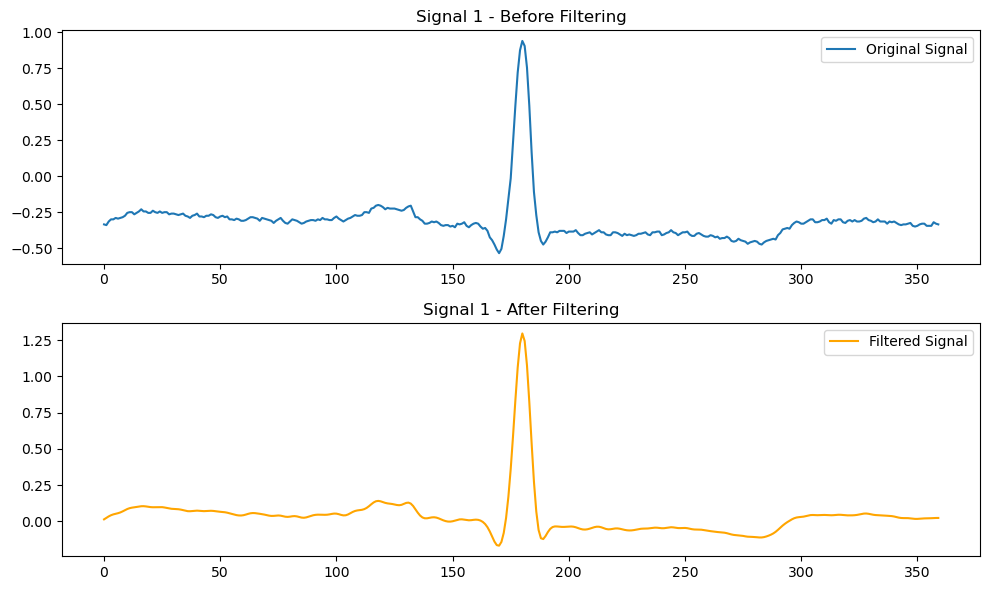

Filtered signal length: 360
Filtered signal sample: [-0.00419151 -0.00125862  0.00443825  0.01374433  0.02494313  0.03486082
  0.04100383  0.04321131  0.0435874   0.04477645]
360


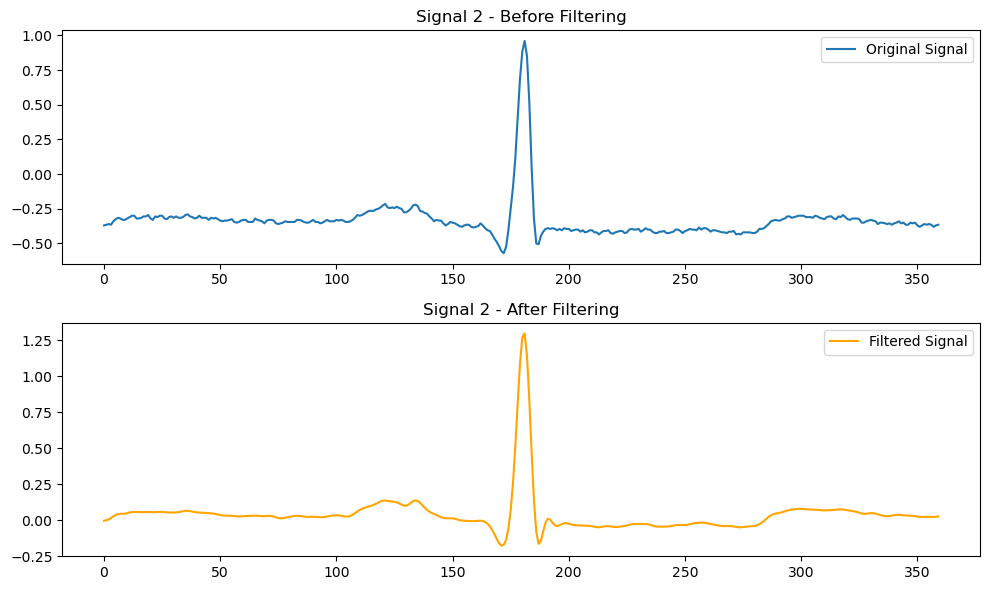

Filtered signal length: 360
Filtered signal sample: [0.00376821 0.02209282 0.03783256 0.04921932 0.05592158 0.05916783
 0.06115332 0.06390919 0.0682738  0.0736547 ]
360


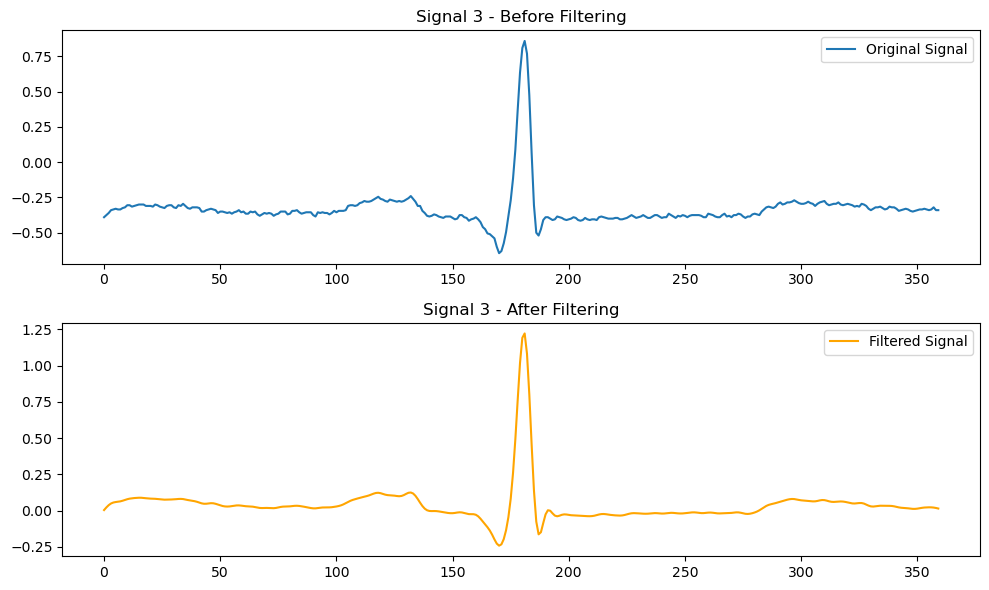

Filtered signal length: 360
Filtered signal sample: [0.01209814 0.01099093 0.01194493 0.01588405 0.02215115 0.02905511
 0.03504619 0.0396449  0.04340434 0.0470006 ]
360


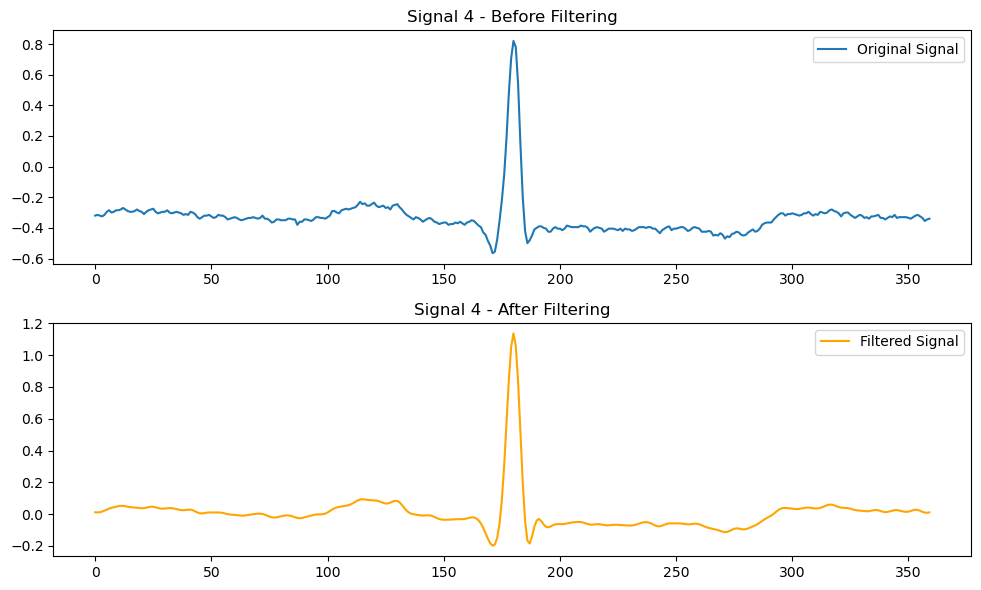

Filtered signal length: 360
Filtered signal sample: [0.00963622 0.02395836 0.03719017 0.04832372 0.05688866 0.06353358
 0.07002739 0.07831742 0.08916865 0.10144548]
360


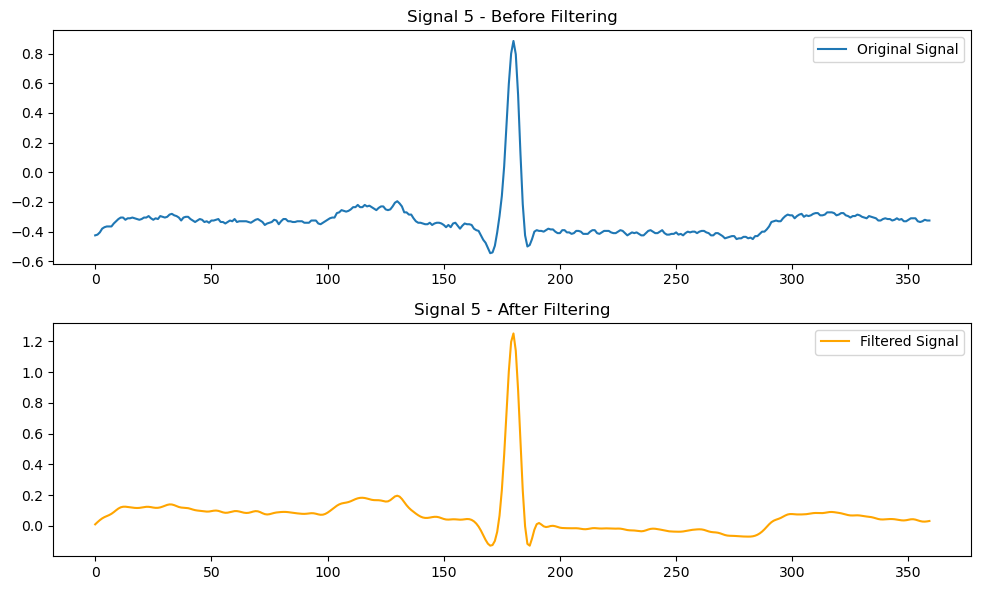

Filtered signal length: 360
Filtered signal sample: [0.02870307 0.04094004 0.05174109 0.0597813  0.06427328 0.06548283
 0.06473654 0.06367722 0.06328732 0.06352463]
Filtered signal length: 360
Filtered signal sample: [-0.03341091 -0.02865226 -0.02561066 -0.02520699 -0.02712169 -0.02996794
 -0.03208723 -0.03256113 -0.03175009 -0.03090177]
Filtered signal length: 360
Filtered signal sample: [ 7.66002472e-05 -6.97503708e-03 -1.12496472e-02 -1.16115276e-02
 -9.04426654e-03 -5.73894298e-03 -3.61010406e-03 -3.35521602e-03
 -4.56621718e-03 -6.49392111e-03]
Filtered signal length: 360
Filtered signal sample: [-1.24830818e-02 -5.92179770e-05  1.03928723e-02  1.81645749e-02
  2.40653828e-02  2.95741817e-02  3.57036968e-02  4.24735163e-02
  4.91937928e-02  5.50612738e-02]
Filtered signal length: 360
Filtered signal sample: [0.0020212  0.0184356  0.03103186 0.03787978 0.03973557 0.0393183
 0.0395777  0.04209553 0.0466015  0.05173247]
Filtered signal length: 360
Filtered signal sample: [-0.01043582

In [7]:
import pandas as pd
# import filtering
# import importlib
# importlib.reload(filtering) # reload 해야 함,,
import matplotlib.pyplot as plt

import numpy
from scipy.signal import butter, filtfilt


def band_pass_filter(data, low_cutoff, high_cutoff, fs, order=2):
    nyquist = 0.5 * fs
    low = low_cutoff / nyquist
    high = high_cutoff / nyquist
    b, a = butter(order, [low, high], btype='band', analog=False)
    y = filtfilt(b, a, data)

    print(f"Filtered signal length: {len(y)}")
    print(f"Filtered signal sample: {y[:10]}") 

    return y


df = pd.read_csv('data_original.csv')

max_plots = 5

cutoff_low = 0.1
cutoff_high = 50
fs = 360 
order = 5

filtered_signals = []

for index, row in df.iterrows():
    # 필터링 전 신호
    original_signal = row.values
    
    # 필터링된 신호
    filtered_signal = band_pass_filter(original_signal, cutoff_low,cutoff_high, fs, order)
    
    filtered_signals.append(filtered_signal)
    if index < max_plots:

        plt.figure(figsize=(10, 6))

        plt.subplot(2, 1, 1)
        plt.plot(original_signal, label='Original Signal')
        plt.title(f'Signal {index + 1} - Before Filtering')
        plt.legend()

        print(len(filtered_signal))

        plt.subplot(2, 1, 2)
        plt.plot(filtered_signal, label='Filtered Signal', color='orange')
        plt.title(f'Signal {index + 1} - After Filtering')
        plt.legend()
    
        plt.tight_layout()
        plt.show()

       
    
filtered_df = pd.DataFrame(filtered_signals)

filtered_df.to_csv('data_filtering.csv', index=False)
